In [ ]:
import pandas as pd
import torch
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import MinMaxScaler
import statistics as stat

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from google.colab import drive
drive.mount('/content/drive')
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# FineTuning ranking



In [ ]:
def predictionsPlot(predTS, start,end,name):
    # Ensure start and end are integers
    start = int(start)
    end = int(end)

    y_true_flat = np.array(predTS["targets"])
    y_pred_flat = np.array(predTS["predictions"])
    plt.figure(figsize=(55, 25))
    if start == -1 and end == -1:
        plt.plot(y_true_flat[:-1], label='True Value')
        plt.plot(y_pred_flat[:-1], label=name)
    else:
        plt.plot(y_true_flat[start:end], label='True Value')
        plt.plot(y_pred_flat[start:end], label=name)
        adjusted_start = start - (start % 24)
        for i in range(adjusted_start, end, 24):
            if i >= start:
                plt.axvline(x=i-start, color='k', linestyle='--')
    plt.title('Results')
    plt.xlabel('Time Step')
    plt.ylabel('Value')
    plt.legend()
    plt.legend(fontsize='large')
    plt.show()

In [ ]:
def predictionsPlotVS(predTS1,predTS2,name1,name2,start,end):
    y_true_flat1 = np.array(predTS1["targets"])
    y_pred_flat1 = np.array(predTS1["predictions"])
    y_pred_flat2 = np.array(predTS2["predictions"])
    y_true_flat2 = np.array(predTS2["targets"])

    plt.figure(figsize=(55, 25))
    if start == -1 and end == -1:
        plt.plot(y_true_flat1[:-1], label=f'True Value{name1}')
        plt.plot(y_pred_flat1[:-1], label=f"predict{name1}")
        plt.plot(y_true_flat2[:-1], label=f"True Value{name2}")
        plt.plot(y_pred_flat2[:-1], label=f"predict{name2}")

    else:
        plt.plot(y_true_flat1[:-1], label=f'True Value{name1}')
        plt.plot(y_pred_flat1[:-1], label=f"predict{name1}")
        plt.plot(y_true_flat2[:-1], label=f"True Value{name2}")
        plt.plot(y_pred_flat2[:-1], label=f"predict{name2}")

        # Ensure the loop starts at the right index for vertical lines
        adjusted_start = start - (start % 24)

        for i in range(adjusted_start, end, 24):
            if i >= start:
                plt.axvline(x=i-start, color='k', linestyle='--')  # Adjust x to align with sliced data plot
    plt.title('Results')
    plt.xlabel('Time Step')
    plt.ylabel('Value')
    plt.legend()
    plt.legend(fontsize='large')
    plt.show()

In [31]:
def flatten_if_nested(lst):

    # Initialize an empty list to store the flattened elements
    flat_list = []

    # Iterate through each element in the input list
    for item in lst:
        # If the element is a list, extend the flat list with the flattened version of this element
        if isinstance(item, list):
            flat_list.extend(flatten_if_nested(item))
        # If the element is not a list, simply append it to the flat list
        else:
            flat_list.append(item)

    return flat_list
# Example usage:
nested_list = [1, [2, 3], [4, [5, 6, [7]]], 8]
flat_list = flatten_if_nested(nested_list)
print(flat_list)

[1, 2, 3, 4, 5, 6, 7, 8]


In [32]:
# inserire anche funzioni di calcolo delle KPI
from sklearn.metrics import median_absolute_error,mean_absolute_error,explained_variance_score
class ResultManager:
  def __init__(self, dfResult):

      self.dfResult = dfResult
      self.mse = 0
      self.rmse = 0
      self.r2 = 0
      self.acc = 0
      self.mae = 0
      self.aae = 0
      self.evs = 0
      self.acper2 = 0
      self.acper5 = 0
      self.ape = 0

  def resultPerformance(self):
    return pd.DataFrame({
          "MSE": [self.mse],
          "RMSE": [self.rmse],
          "R2": [self.r2],
          "ACCURACY": [self.acc],
          "MAE" : [self.mae],
          "AV-AE": [self.aae],
          "Explane variance":[self.evs],
          "ACPER2": [self.acper2],
          "ACPER5": [self.acper5],
          "APE": [self.ape]
      })
  def setMse(self, mse):
    self.mse = mse
  def setRmse(self, rmse):
    self.rmse = rmse
  def setR2(self, r2):
    self.r2 = r2
  def setAcc(self,acc):
    self.acc = acc
  def setMae(self,mae):
    self.mae = mae
  def setAae(self,aae):
    self.aae = aae
  def setEvs(self,evs):
    self.evs = evs
  def setAcper2(self,acper2):
    self.acper2= acper2
  def setAcper5(self,acper5):
    self.acper5= acper5
  def setApe(self,ape):
    self.ape=ape

  def acper_complessivo(self,val):
    threshold = val
    # Calcolo del limite inferiore e superiore
    lower_bound = self.dfResult["targets"] - (threshold * self.dfResult["targets"])
    upper_bound = self.dfResult["targets"] + (threshold * self.dfResult["targets"])
    # Controllo se y_pred è tra i limiti e calcolo la percentuale di True
    matches = (self.dfResult["predictions"] >= lower_bound) & (self.dfResult["predictions"] <= upper_bound)
    # Calcolo la percentuale di corrispondenze soddisfacenti la condizione
    percentuale_acper = (matches.sum() / len(self.dfResult)) * 100
    return percentuale_acper


  def overallKpiCompute(self):

    self.mse = mean_squared_error(self.dfResult["targets"],self.dfResult["predictions"])
    self.rmse = mean_squared_error(self.dfResult["targets"],self.dfResult["predictions"], squared=False)
    self.r2 = r2_score(self.dfResult["targets"],self.dfResult["predictions"])
    self.mae = mean_absolute_error(self.dfResult["targets"],self.dfResult["predictions"])
    self.aae = median_absolute_error(self.dfResult["targets"],self.dfResult["predictions"])
    self.evs = explained_variance_score(self.dfResult["targets"],self.dfResult["predictions"])
    self.acper2 = self.acper_complessivo(0.02)
    self.acper5 = self.acper_complessivo(0.05)
    self.ape =  np.mean((np.abs(self.dfResult["predictions"]) - self.dfResult["targets"]) / np.array(self.dfResult["targets"]), axis=0)

    #  compute accuracy
    real = self.dfResult["targets"]
    predict = self.dfResult["predictions"]
    percentage = 1 - np.sqrt(np.mean(np.square((real - predict) / real)))
    self.acc =  percentage * 100
    KpiDf = self.resultPerformance()
    # calcola anche la accuracy
    return KpiDf




  def mseStepByStepDf(self,dfPredTargetMSE):

    for i in range(len(dfPredTargetMSE)):
    # Ensure the true and predicted values are passed as lists
      mse = mean_squared_error([dfPredTargetMSE.at[i,"targets"]], [dfPredTargetMSE.at[i,"predictions"]])
      dfPredTargetMSE.at[i, "mse"] = mse

    mse_mean = mean_squared_error(dfPredTargetMSE["targets"], dfPredTargetMSE["predictions"])
    return dfPredTargetMSE

  def tableResultWandb(self,typeDS):
    true_values = self.dfResult["targets"]
    predictions = self.dfResult["predictions"]
    results_table = wandb.Table(columns=[f"True Values_{typeDS}", f"Predictions_{typeDS}"])

    # Aggiungi i dati alla tabella
    for true, pred in zip(true_values, predictions):
        results_table.add_data(true, pred)

    # Log la tabella su wandb
    wandb.log({"Prediction vs True": results_table})

  def tableResultCSV(self,typeDS):
    true_values = self.dfResult["targets"]
    predictions = self.dfResult["predictions"]
    df = pd.DataFrame({"True Values": true_values, "Predictions": predictions})
    path_to_save = "/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]"
    filename = f"RWIN_CNNLSTMohlc4_output_{typeDS}.csv"
    full_path = f"{path_to_save}{filename}"
    df.to_csv(full_path, index=False)
    print("Uploaded {filename} to drive")

In [ ]:
class CNNLSTMModel(nn.Module):

  def __init__(self, input_size, num_lstm_layers, dropout,
               sequence_length,nStepsAhead):
    super().__init__()

    # model definition
    self.hybridNetwork = nn.Sequential(
        nn.Conv1d(in_channels=input_size,
                  out_channels=sequence_length,
                  kernel_size=1),
        nn.ReLU(),
        nn.LSTM(input_size=sequence_length,
                hidden_size=sequence_length,
                num_layers=num_lstm_layers,
                dropout=dropout,
                batch_first=False),
    )
    self.endLinearLayer = nn.Linear(sequence_length,nStepsAhead)

  def forward(self, x):
    # Apply CNN layers
    x = x.permute(0, 2, 1)
    x = self.hybridNetwork[0](x)  # Conv1d
    x = self.hybridNetwork[1](x)  # ELU activation

    # Permute the dimensions for LSTM
    x = x.permute(2, 0, 1)

    # Apply LSTM layers
    x, (hidden, cell) = self.hybridNetwork[2](x)

    # Only take the output from the last time-step
    x = x[-1, :, :]

    # Apply final linear layer
    x = self.endLinearLayer(x)
    return x


class HybridModelFCLSTM(nn.Module):

  def __init__(self,input_size,num_lstm_layers,dropout,
               window_size,nStepsAhead):
    super().__init__()

    # Definizione del modello usando nn.Sequential
    self.hybridNetwork = nn.Sequential(
        nn.Linear(input_size, window_size),
        nn.ReLU(),
        nn.Linear(window_size,window_size),
        nn.ReLU(),
        nn.Dropout(dropout),
        nn.LSTM(input_size=window_size,
                hidden_size=window_size,
                num_layers=num_lstm_layers,
                dropout=dropout, # il dropout viene inserito qui o devo inserire io nella pipline lo strato di dropOut?
                batch_first=False),
    )
    self.endLinearLayer = nn.Linear(window_size,nStepsAhead)

  def forward(self, x):
    # Apply FC layers
   # x = x.permute(0, 2, 1)
    x = self.hybridNetwork[0](x)
    x = self.hybridNetwork[1](x)

    # Permute the dimensions for LSTM
    x = x.permute(1, 0, 2)


    # Apply LSTM layers
    x, (hidden, cell) = self.hybridNetwork[5](x)

    # Only take the output from the last time-step
    x = x[-1, :, :]

    # Apply final linear layer
    x = self.endLinearLayer(x)
    return x



# CNNLSTM24h OC2 optimisation ranking

## 1. youthfulSweep4Model



```
CNNLSTMModel(
 83   (hybridNetwork): Sequential(
 84     (0): Conv1d(61, 176, kernel_size=(1,), stride=(1,))
 85     (1): ReLU()
 86     (2): LSTM(176, 176, num_layers=3, dropout=0.5255918882358939)
 87   )
 88   (endLinearLayer): Linear(in_features=176, out_features=24, bias=True)
 89 )
```



In [ ]:
KPITSyou4 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep4KPI.csv")
predTSyou4 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep4predictions_t2cs7uv6.csv")


config = {
    "alphaRMS": 0.8878535830123158,
    "batch_size": 128,
    "device": "cuda",
    "dimTrValDataSet": 0.8135103108199945,
    "dropout": 0.5255918882358939,
    "eps": 0.00000001809781643808,
    "input_size": 61,
    "l1_factor": 0.00001788764196672363,
    "l1_lambda": 0.00985428675707348,
    "learning_rateAdam": 0.000654610999498754,
    "learning_rateRMS": 0.04441832592851753,
    "method": "random",
    "metric": {
        "goal": "minimize",
        "name": "avg_TestLoss",
        "min_delta": 0.0035540167852985117
    },
    "momentumRMS": 0.726408866481537,
    "nStepsAhead": 24,
    "num_epochs": 633,
    "num_lstm_layers": 3,
    "optimizer": "Adam",
    "patience": 38,
    "scheduler": "ReduceLROnPlateau",
    "scheduler_factor": {
        "CosineAnnealingWarmRestarts": 1.1189226291910723,
        "ReduceLROnPlateau": 0.7502387107470798
    },
    "scheduler_min_lr": {
        "CosineAnnealingWarmRestarts": 0.0000986804709547241,
        "ReduceLROnPlateau": 0.00025800234809786196
    },
    "scheduler_patience": {
        "CosineAnnealingWarmRestarts": 5.485778505433907,
        "ReduceLROnPlateau": 8.645318720669717
    },
    "test_split_size": 0.14632058556123811,
    "trW": 20,
    "vlWl": 17,
    "weight_decay": {
        "Adam": 0.0008131241983869834,
        "RMS": 0.004928825586952906
    },
    "window_size": 176
}

youthfu4lModel = CNNLSTMModel(config["input_size"],config["num_lstm_layers"], config["dropout"],config["window_size"],config["nStepsAhead"])
model_path = '/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep4OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT]t2cs7uv6.pth'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
youthfu4lModel.load_state_dict(torch.load(model_path, map_location=device))
youthfu4lModel = youthfu4lModel.to(device)
youthfu4lModel.eval()
KPITSyou4.head()

,Unnamed: 0,MSE,RMSE,R2,ACCURACY,MAE,AV-AE,Explane variance,ACPER2,ACPER5,APE,Dataset
0,0,0.000921,0.030349,0.986741,-58.211612,0.023657,0.019507,0.986741,11.493056,27.994792,0.379548,Training
1,1,0.000599,0.024475,0.991098,73.132917,0.020042,0.017630,0.991101,11.341146,26.848958,-0.049145,Validation
2,2,0.000187,0.013658,0.983748,96.557466,0.010854,0.009141,0.983817,41.009852,85.283251,-0.001806,Test


In [ ]:
predTSyou4.head()

,targets,predictions
0,0.211612,0.203979
1,0.211408,0.203916
2,0.210893,0.204011
3,0.210970,0.203956
4,0.211192,0.204017


### Scatter on TestSet

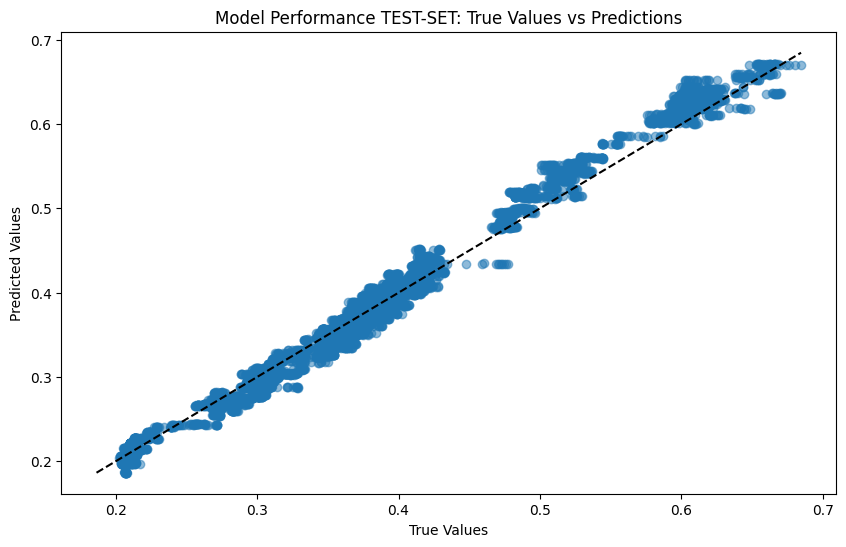

In [ ]:
y_true_flat = np.array(predTSyou4["targets"])
y_pred_flat = np.array(predTSyou4["predictions"])

    # Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(y_true_flat, y_pred_flat, alpha=0.5)
plt.title('Model Performance TEST-SET: True Values vs Predictions')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')

    # Plot the perfect prediction line
max_val = max(y_true_flat.max(), y_pred_flat.max())
min_val = min(y_true_flat.min(), y_pred_flat.min())
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

plt.show()

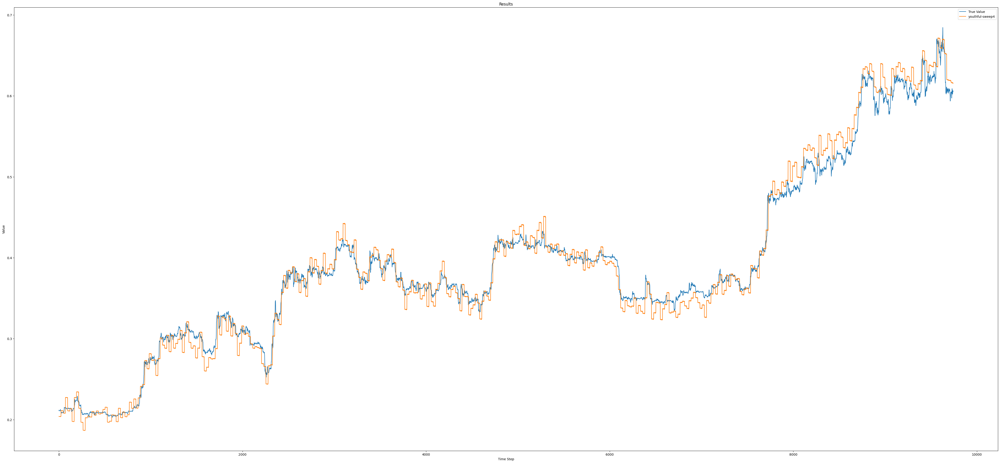

In [ ]:
predictionsPlot(predTSyou4,-1,-1,"youthful-sweep4")

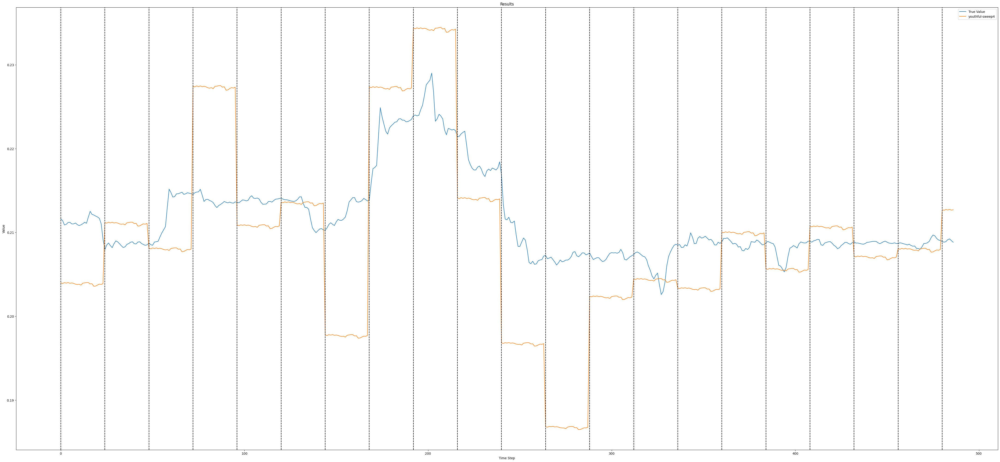

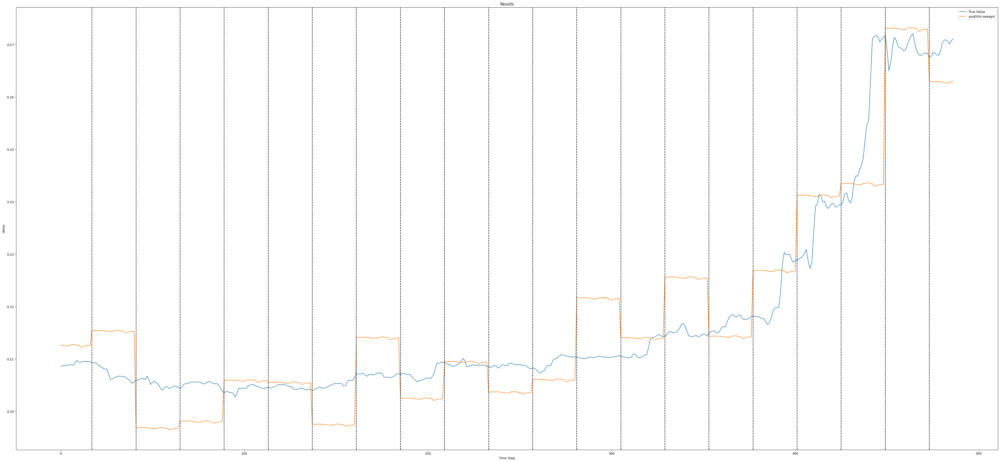

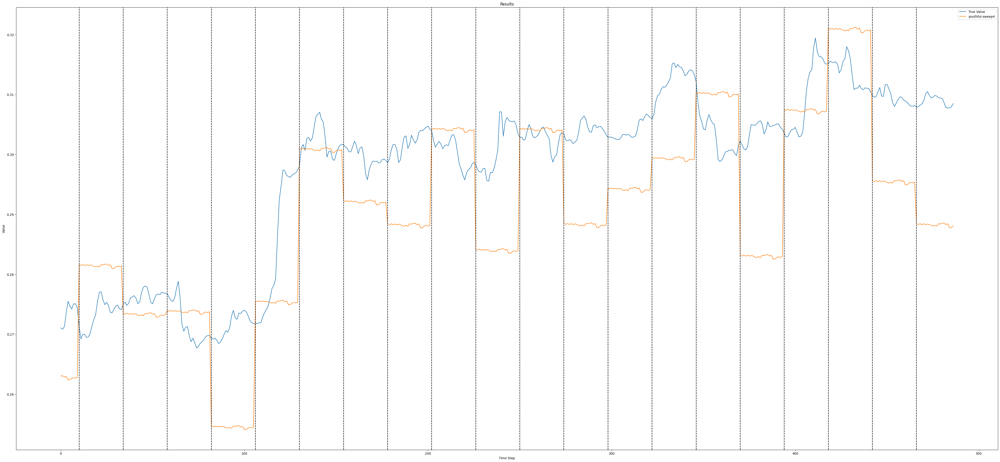

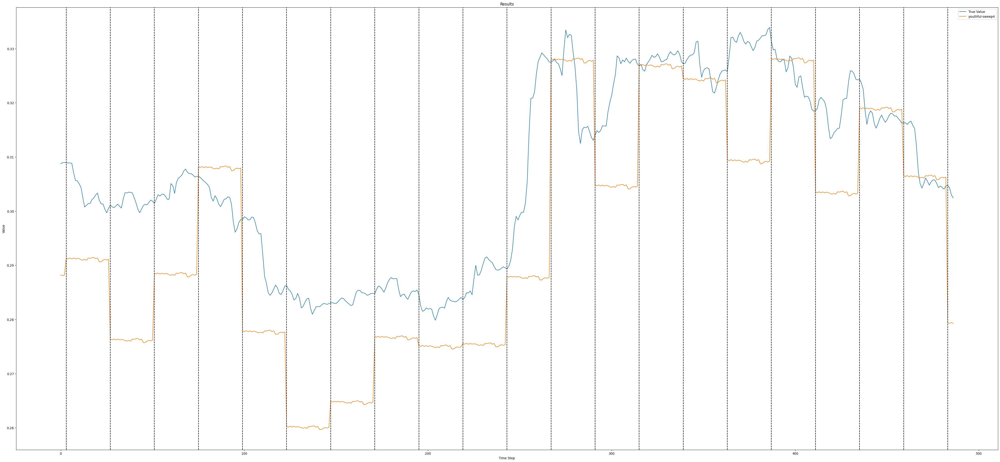

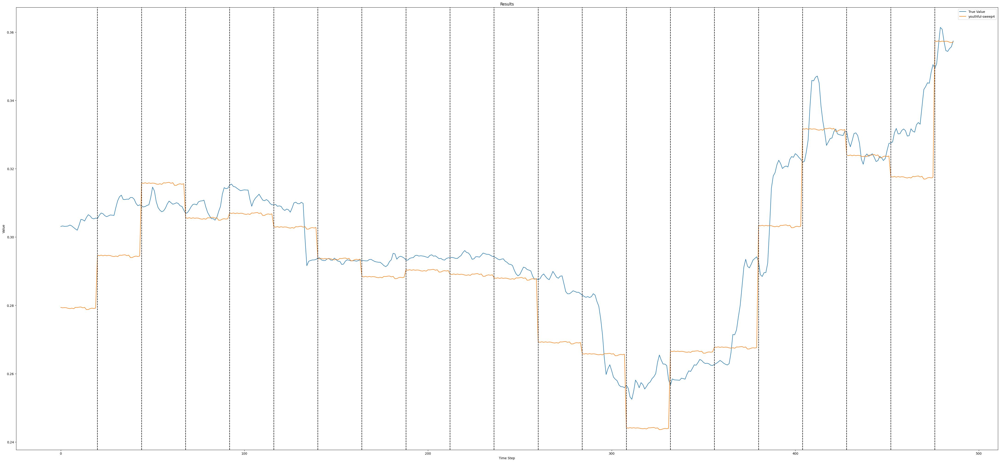

...

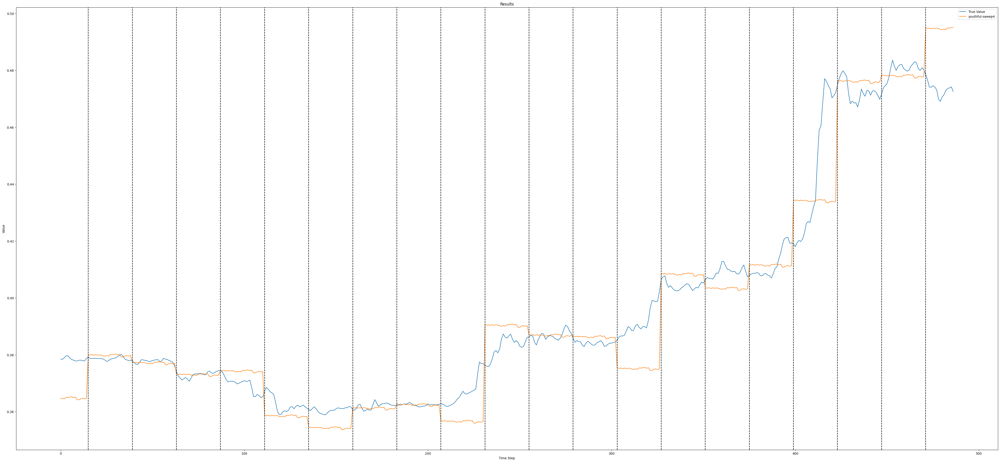

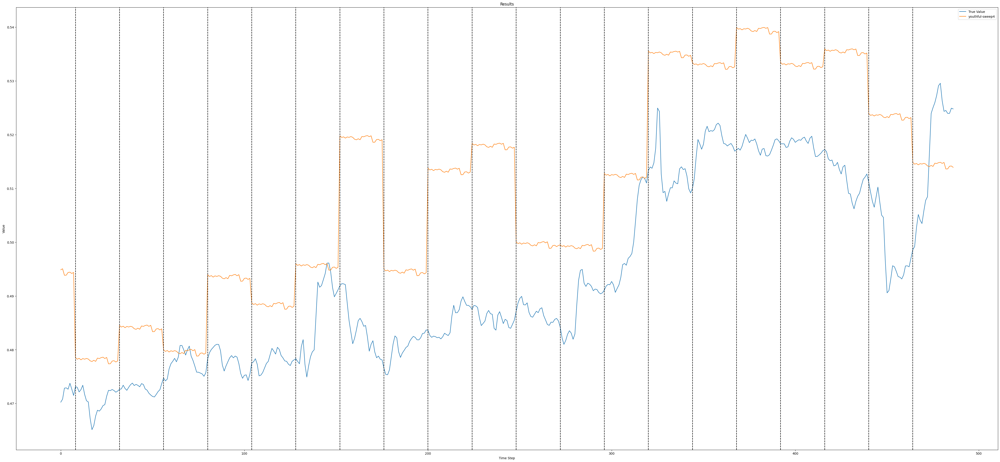

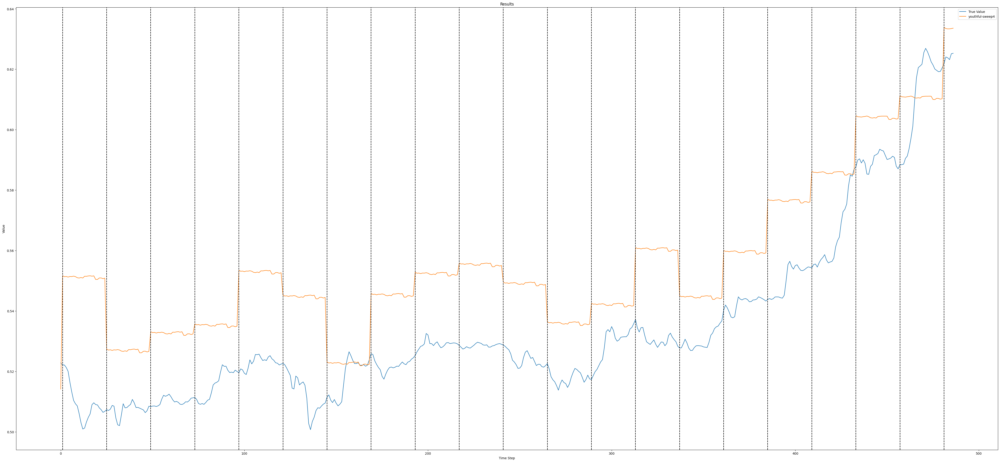

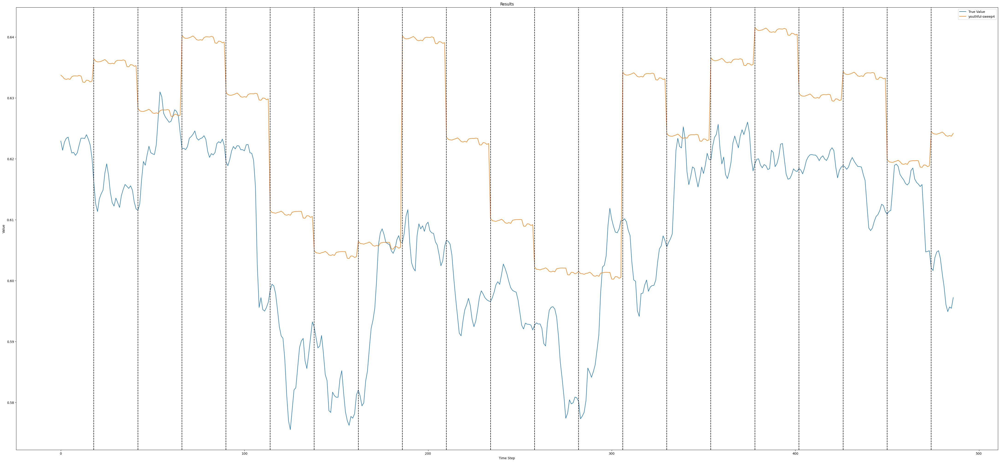

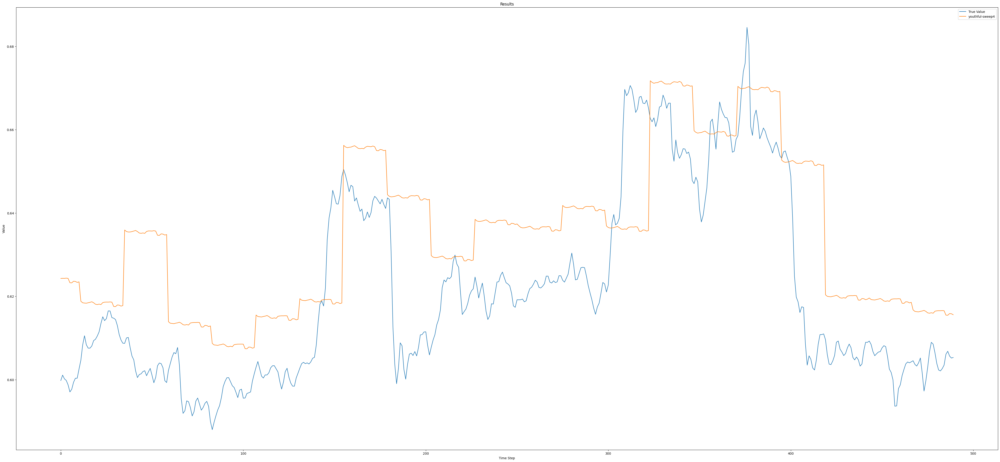

In [ ]:
total_steps = len(predTSyou4['targets'])
segment_length = total_steps // 20
for segment in range(20):
    start = segment * segment_length
    if segment < 19:
        end = (segment + 1) * segment_length
    else:
        end = -1  # Ensure we capture the last segment completely in case it doesn't divide evenly
    predictionsPlot(predTSyou4, start, end,"youthful-sweep4")

##2. youthfulSweep1Model


si chiama youthfulSweep1 (coreggi)
```
CNNLSTMModel(
 85   (hybridNetwork): Sequential(
 86     (0): Conv1d(61, 107, kernel_size=(1,), stride=(1,))
 87     (1): ReLU()
 88     (2): LSTM(107, 107, num_layers=2, dropout=0.47729819441564975)
 89   )
 90   (endLinearLayer): Linear(in_features=107, out_features=24, bias=True)
 91 )
```



In [ ]:
KPITSyou2 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep-2KPI.csv")
predTSyou2 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep-2best_predictions.csv")

config = ({
    "alphaRMS": 0.8090629456939943,
    "batch_size": 256,
    "device": "cuda",
    "dimTrValDataSet": 0.8287586984440504,
    "dropout": 0.47729819441564975,
    "eps": 0.00000001239315541506,
    "input_size": 61,
    "l1_factor": 0.00000801726287205171,
    "l1_lambda": 0.008624243414141938,
    "learning_rateAdam": 0.00047672560850465183,
    "learning_rateRMS": 0.03200644582058168,
    "method": "random",
    "min_delta": 0.006096607563388158,
    "momentumRMS": 0.963606595029008,
    "nStepsAhead": 24,
    "num_epochs": 751,
    "num_lstm_layers": 2,
    "optimizer": "Adam",
    "patience": 75,
    "scheduler": "CosineAnnealingWarmRestarts",
    "scheduler_factorCosineAnnealingWarmRestarts": 1.4322512566039018,
    "scheduler_factorReduceLROnPlateau": 0.3594300317882112,
    "scheduler_min_lrCosineAnnealingWarmRestarts": 0.00006547923293479863,
    "scheduler_min_lrReduceLROnPlateau": 0.0004098525090052048,
    "scheduler_patience": 18,
    "scheduler_patienceCosineAnnealingWarmRestarts": 4.026656767962747,
    "scheduler_patienceReduceLROnPlateau": 8.324588475863347,
    "test_split_size": 0.18050278863998653,
    "trW": 16,
    "vlWl": 5,
    "weight_decayAdam": 0.0009572119939357342,
    "weight_decayRMS": 0.0006475907082396568,
    "window_size": 107,
    "input_size": 61

})

youthfu2lModel = CNNLSTMModel(config["input_size"],config["num_lstm_layers"], config["dropout"],config["window_size"],config["nStepsAhead"])
model_path = '/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_CNNLSTM1/LC2_prediction[tr&vlW-24h-noOPT]/OPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT])/youthful-sweep-2best_predictionsOPTRWIN_CNNLSTM (LC2[tr&vlW-24h-noOPT]dljui583.pth'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
youthfu2lModel.load_state_dict(torch.load(model_path, map_location=device))
youthfu2lModel = youthfu2lModel.to(device)
youthfu2lModel.eval()
KPITSyou2.head()

,Unnamed: 0,MSE,RMSE,R2,ACCURACY,MAE,AV-AE,Explane variance,ACPER2,ACPER5,APE,Dataset
0,0,0.001998,0.044700,0.970362,-inf,0.032958,0.024378,0.970374,7.294695,19.022529,inf,Training
1,1,0.001485,0.038538,0.977577,70.129851,0.029107,0.023148,0.977613,8.039608,21.635780,-0.047646,Validation
2,2,0.000440,0.020977,0.953516,94.599183,0.018701,0.018570,0.989390,14.360517,53.954991,-0.046912,Test


In [ ]:
predTSyou2.head()

,targets,predictions
0,0.210125,0.215568
1,0.210076,0.215565
2,0.210084,0.215579
3,0.210251,0.215586
4,0.210410,0.215550


### Scatter on TestSet

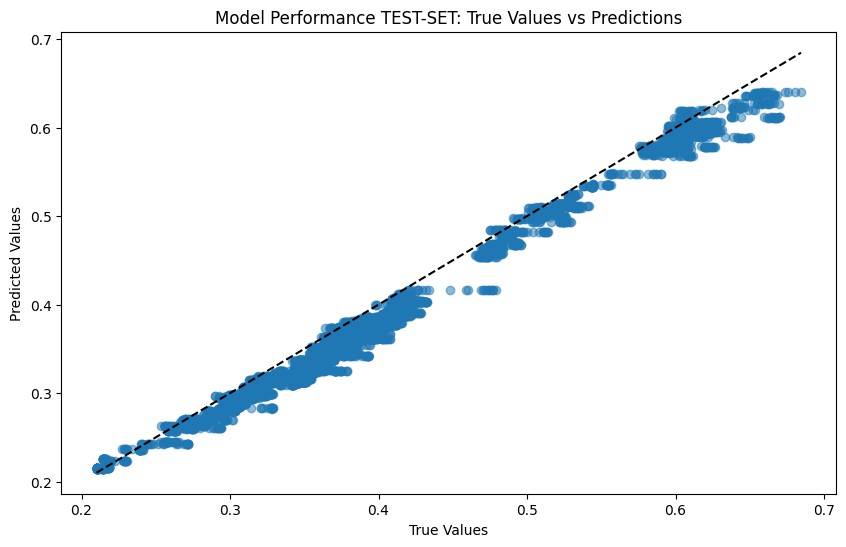

In [ ]:

y_true_flat = np.array(predTSyou2["targets"])
y_pred_flat = np.array(predTSyou2["predictions"])

    # Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(y_true_flat, y_pred_flat, alpha=0.5)
plt.title('Model Performance TEST-SET: True Values vs Predictions')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')

    # Plot the perfect prediction line
max_val = max(y_true_flat.max(), y_pred_flat.max())
min_val = min(y_true_flat.min(), y_pred_flat.min())
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

plt.show()

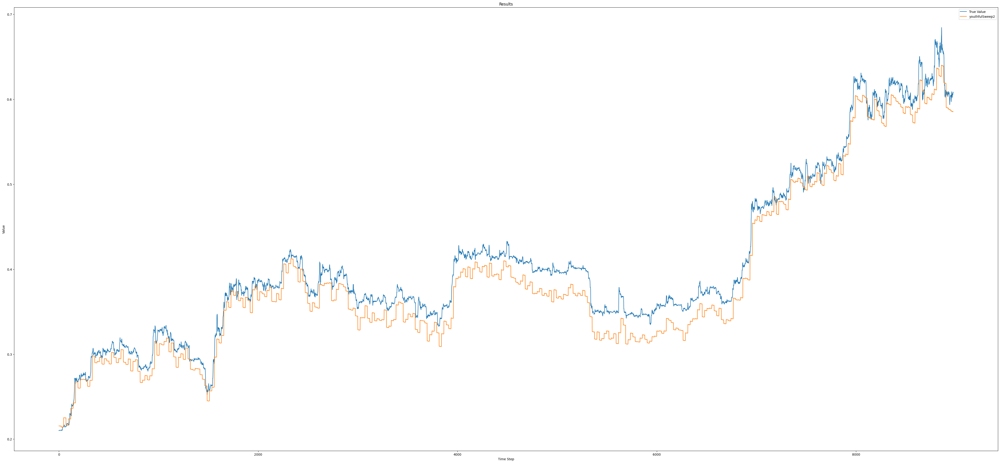

In [ ]:
predictionsPlot(predTSyou2,-1,-1,"youthfulSweep2")

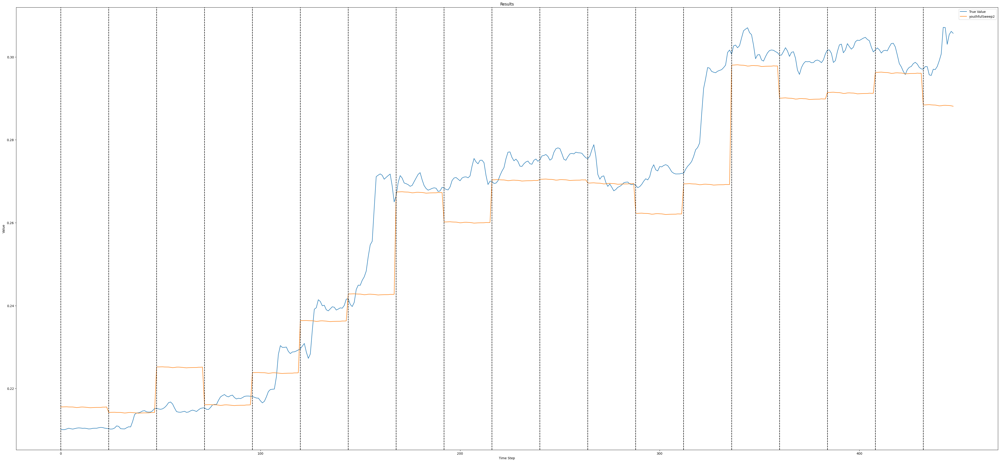

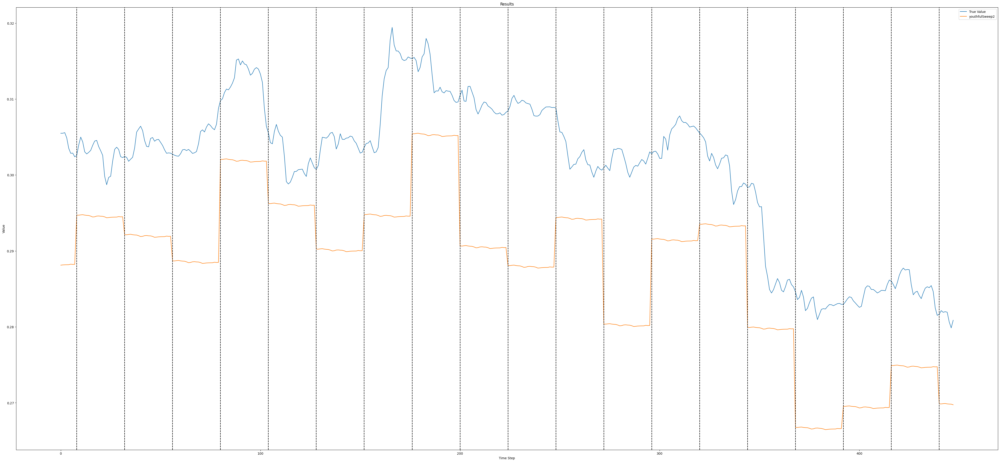

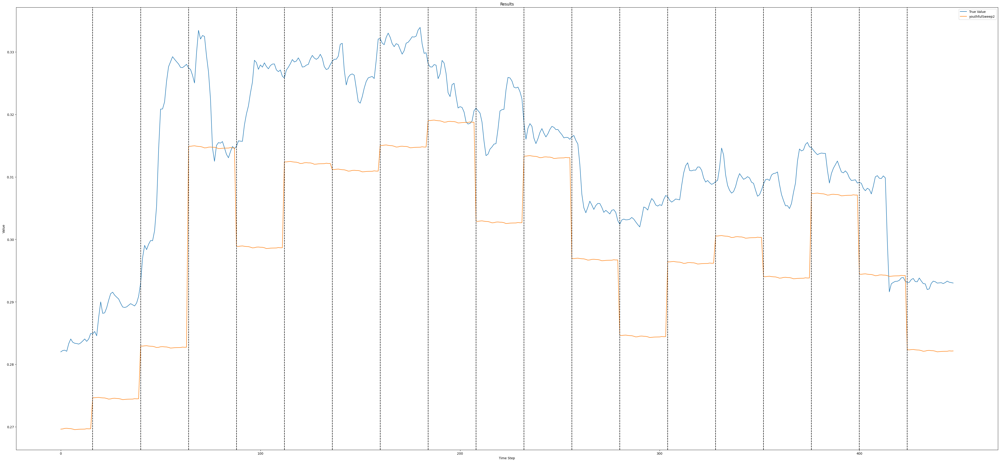

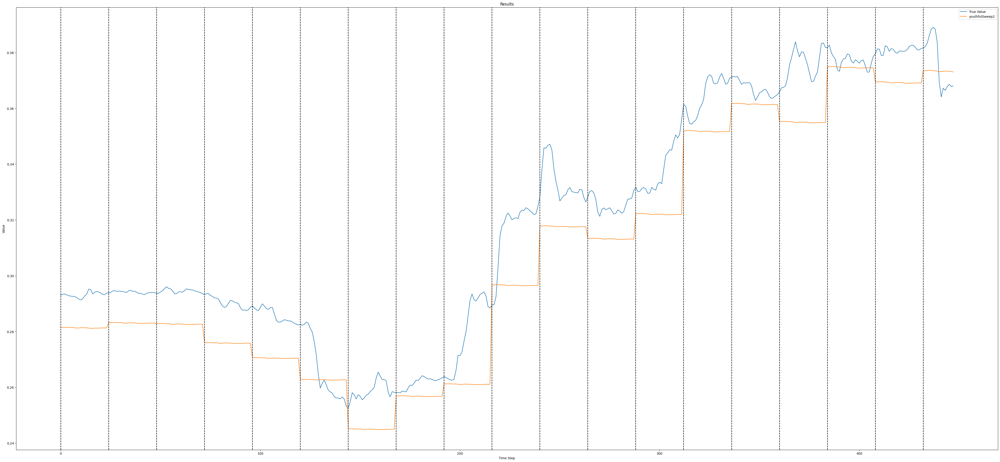

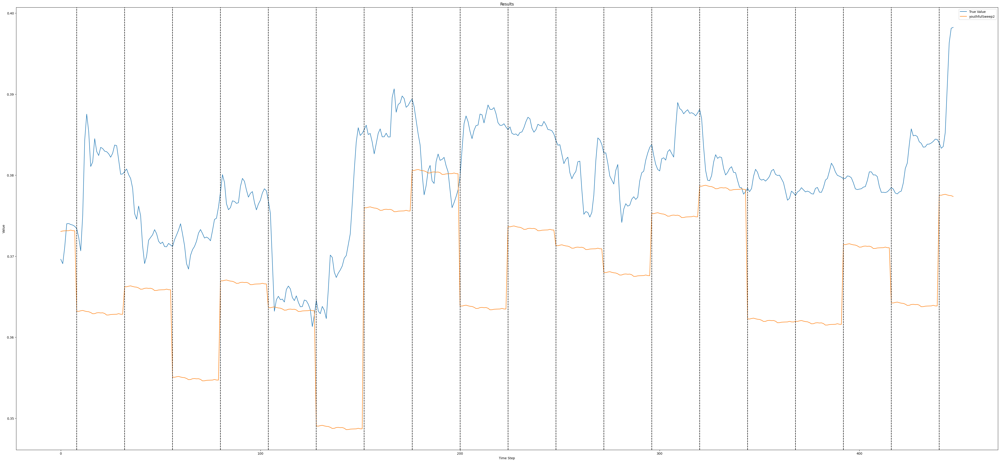

...

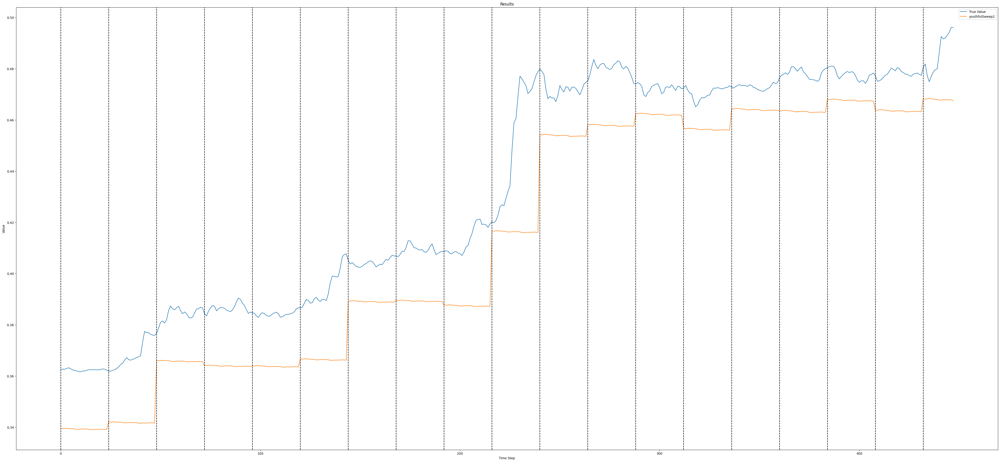

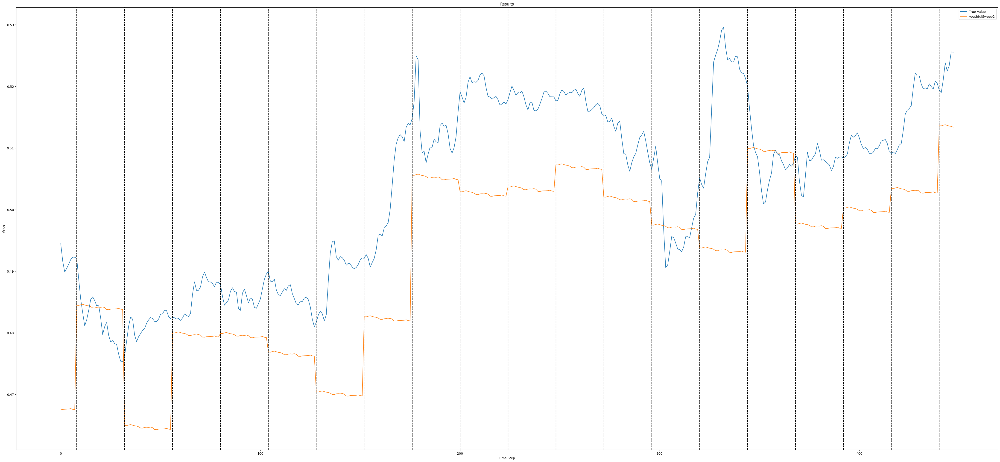

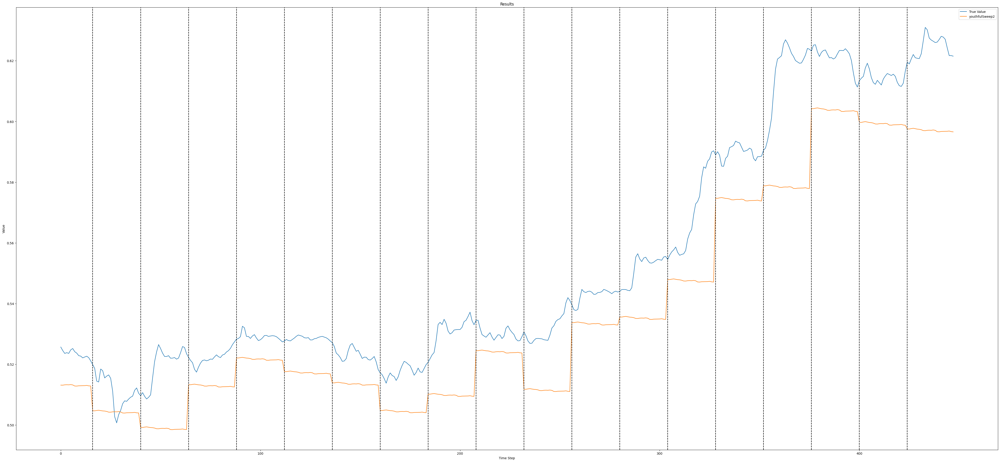

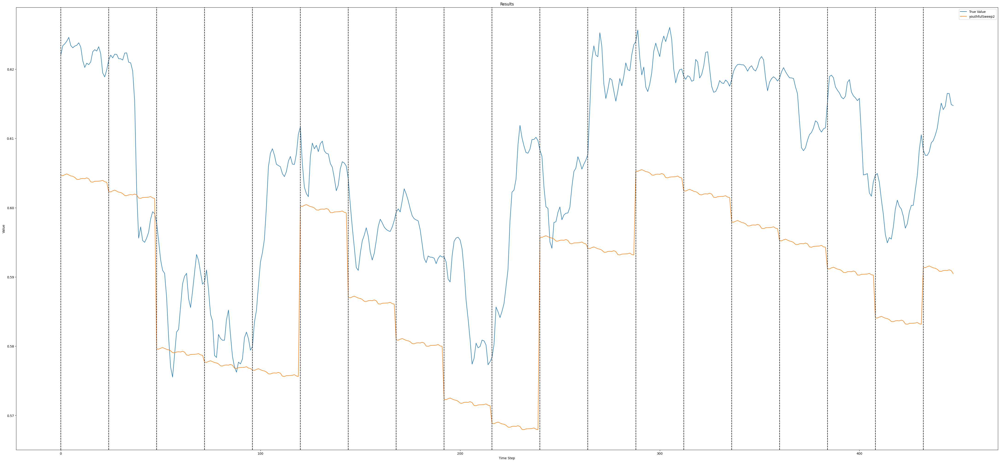

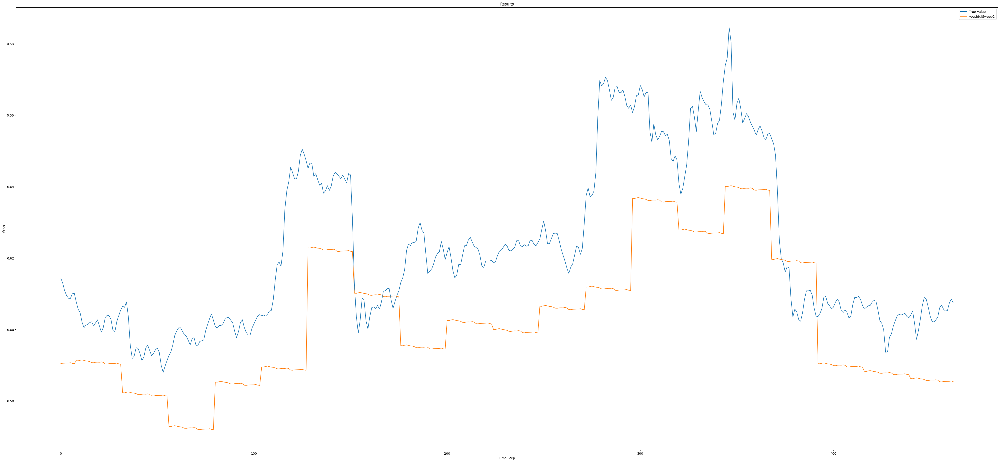

In [ ]:
total_steps = len(predTSyou2['targets'])
segment_length = total_steps // 20
for segment in range(20):
    start = segment * segment_length
    if segment < 19:
        end = (segment + 1) * segment_length
    else:
        end = -1  # Ensure we capture the last segment completely in case it doesn't divide evenly
    predictionsPlot(predTSyou2, start, end,"youthfulSweep2")

In [ ]:
KPITSyou2['ModelName'] = 'youthful-sweep2'
KPITSyou4['ModelName'] = 'youthful-sweep4'
KPIrank = pd.concat([KPITSyou2,KPITSyou4])
KPIrank.reset_index(drop=True, inplace=True)
KPIrank.drop(columns=['Unnamed: 0'], inplace=True)
# Rimuovi le colonne "ModelName" e "Dataset" dal DataFrame
model_name_col = KPIrank.pop('ModelName')
dataset_col = KPIrank.pop('Dataset')

# Inserisci le colonne "ModelName" e "Dataset" alle posizioni desiderate
KPIrank.insert(0, 'ModelName', model_name_col)
KPIrank.insert(1, 'Dataset', dataset_col)
KPIrank

,ModelName,Dataset,MSE,RMSE,R2,ACCURACY,MAE,AV-AE,Explane variance,ACPER2,ACPER5,APE
0,youthful-sweep2,Training,0.001998,0.044700,0.970362,-inf,0.032958,0.024378,0.970374,7.294695,19.022529,inf
1,youthful-sweep2,Validation,0.001485,0.038538,0.977577,70.129851,0.029107,0.023148,0.977613,8.039608,21.635780,-0.047646
2,youthful-sweep2,Test,0.000440,0.020977,0.953516,94.599183,0.018701,0.018570,0.989390,14.360517,53.954991,-0.046912
3,youthful-sweep4,Training,0.000921,0.030349,0.986741,-58.211612,0.023657,0.019507,0.986741,11.493056,27.994792,0.379548
4,youthful-sweep4,Validation,0.000599,0.024475,0.991098,73.132917,0.020042,0.017630,0.991101,11.341146,26.848958,-0.049145
5,youthful-sweep4,Test,0.000187,0.013658,0.983748,96.557466,0.010854,0.009141,0.983817,41.009852,85.283251,-0.001806


## Comparisation chart

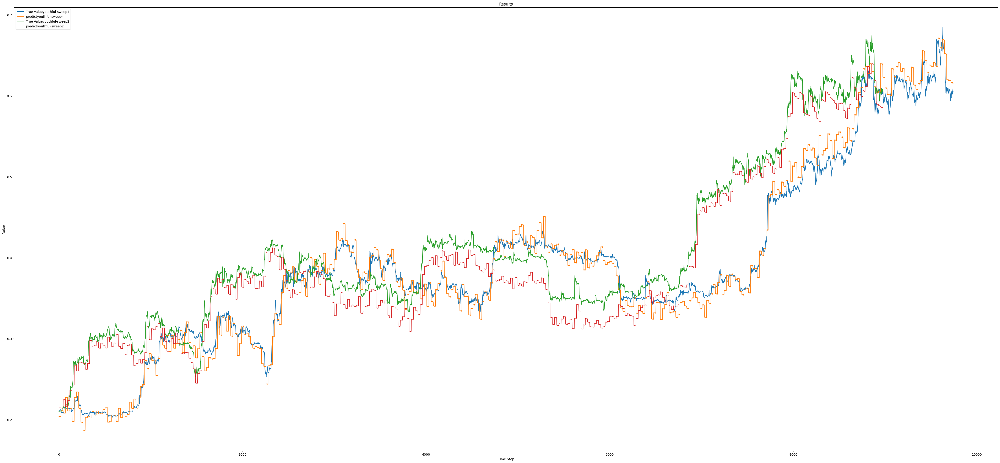

you4 dim:9744 and you2 dim:8976


In [ ]:
predictionsPlotVS(predTSyou4,predTSyou2,"youthful-sweep4","youthful-sweep2",-1,-1)
print(f"you4 dim:{len(predTSyou4)} and you2 dim:{len(predTSyou2)}")

# FCLSTM24h OC2 optimisation ranking

## Helpful-sweep9-Model


model design



```
   9 HybridModelFCLSTM(
  10   (hybridNetwork): Sequential(
  11     (0): Linear(in_features=61, out_features=263, bias=True)
  12     (1): ReLU()
  13     (2): Linear(in_features=263, out_features=263, bias=True)
  14     (3): ReLU()
  15     (4): Dropout(p=0.4670089809514272, inplace=False)
  16     (5): LSTM(263, 263, num_layers=2, dropout=0.4670089809514272)
  17   )
  18   (endLinearLayer): Linear(in_features=263, out_features=24, bias=True)
  19 )
```

Mean Train Loss: 0.004025427470048232
Val Loss : 0.0028891898693271085
TestLoss: 0.000394315917219501


In [47]:
config = {
    "alphaRMS": 0.8931958352252699,
    "batch_size": 256,
    "device": "cuda",
    "dimTrValDataSet": 0.8041719113505793,
    "dropout": 0.4670089809514272,
    "eps": 0.00000000560865229286,
    "input_size": 61,
    "l1_factor": 0.00001179295334288942,
    "l1_lambda": 0.01395202275317714,
    "learning_rateAdam": 0.0002981916668664188,
    "learning_rateRMS": 0.002939947219071621,
    "method": "random",
    "metric_goal": "minimize",
    "name": "avg_TestLoss",
    "min_delta": 0.006186789669617839,
    "momentumRMS": 0.9607498391863232,
    "nStepsAhead": 24,
    "num_epochs": 799,
    "num_lstm_layers": 2,
    "optimizer": "Adam",
    "parameters": {},  # Inserisci i parametri qui se necessario
    "patience": 50,
    "scheduler": "ReduceLROnPlateau",
    "scheduler_factorCosineAnnealingWarmRestarts": 1.186262520225567,
    "scheduler_factorReduceLROnPlateau": 0.44116438264894053,
    "scheduler_min_lrCosineAnnealingWarmRestarts": 0.00008490199472390513,
    "scheduler_min_lrReduceLROnPlateau": 0.00030188550025860234,
    "scheduler_patience": 3,
    "scheduler_patienceCosineAnnealingWarmRestarts": 7.104343133457166,
    "scheduler_patienceReduceLROnPlateau": 7.546579428738721,
    "test_split_size": 0.1895577033122585,
    "trW": 28,
    "vlWl": 10,
    "weight_decayAdam": 0.000820582927952743,
    "weight_decayRMS": 0.003202787466403534,
    "window_size": 263
}


KPITShelp9 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_FCLSTM/predictionCSV[OC2,trValW,24h,noOPT]/testMigliorPredizione/helpful-sweep9KPI.csv")
predTShelp9 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_FCLSTM/predictionCSV[OC2,trValW,24h,noOPT]/testMigliorPredizione/helpful-sweep9predictions.csv")
help9Model = HybridModelFCLSTM(config["input_size"],config["num_lstm_layers"], config["dropout"],config["window_size"],config["nStepsAhead"])
model_path = '/content/drive/MyDrive/Colab Notebooks/ResultOutput/RWIN_FCLSTM/predictionCSV[OC2,trValW,24h,noOPT]/testMigliorPredizione/helpful-sweep9MODELFCLSTMOC2_hc0kmbj4.pth'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
help9Model.load_state_dict(torch.load(model_path, map_location=device))
help9Model = youthfu4lModel.to(device)
help9Model.eval()


pred =  flatten_if_nested(np.array(predTShelp9["Predictions"]))
pred = [float(numero) for stringa in pred for numero in stringa.strip('[]').split(',')]

true = predTShelp9["True Values"].values.flatten()
true = [float(numero) for stringa in true for numero in stringa.strip('[]').split(',')]

# Stampa del vettore risultante
predTShelp9 = pd.DataFrame({
    "targets": true,
    "predictions": pred
})

predTShelp9.head()



,targets,predictions
0,0.206496,0.202541
1,0.206477,0.202563
2,0.206216,0.202586
3,0.205914,0.202609
4,0.205631,0.202653


In [49]:
resultManager = ResultManager(predTShelp9)
resultManager.overallKpiCompute()
KPITShelp9 = resultManager.resultPerformance()
KPITShelp9.head()

,MSE,RMSE,R2,ACCURACY,MAE,AV-AE,Explane variance,ACPER2,ACPER5,APE
0,0.000343,0.018521,0.972115,95.692513,0.014914,0.013278,0.98801,26.359338,71.375099,-0.033524


## Scatter on TestSet

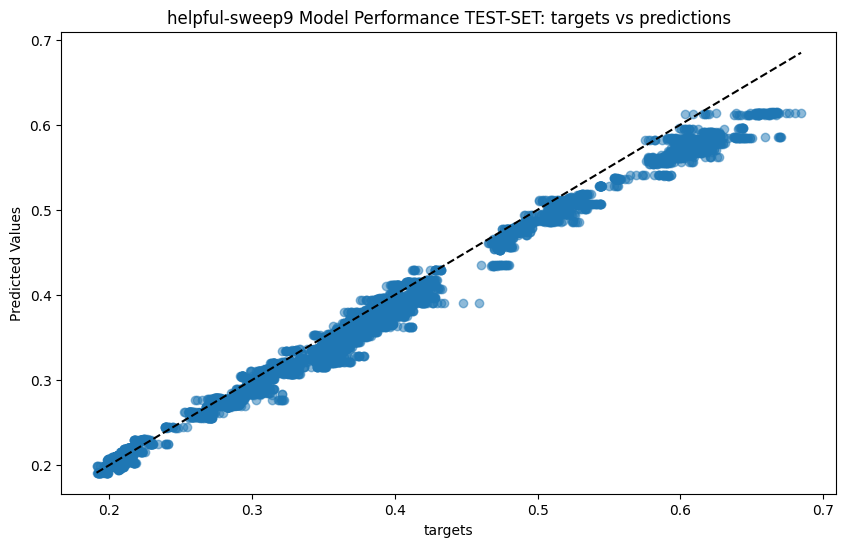

In [51]:
y_true_flat = np.array(predTShelp9["targets"])
y_pred_flat = np.array(predTShelp9["predictions"])

    # Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(y_true_flat, y_pred_flat, alpha=0.5)
plt.title('helpful-sweep9 Model Performance TEST-SET: targets vs predictions')
plt.xlabel('targets')
plt.ylabel('Predicted Values')

    # Plot the perfect prediction line
max_val = max(y_true_flat.max(), y_pred_flat.max())
min_val = min(y_true_flat.min(), y_pred_flat.min())
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

plt.show()

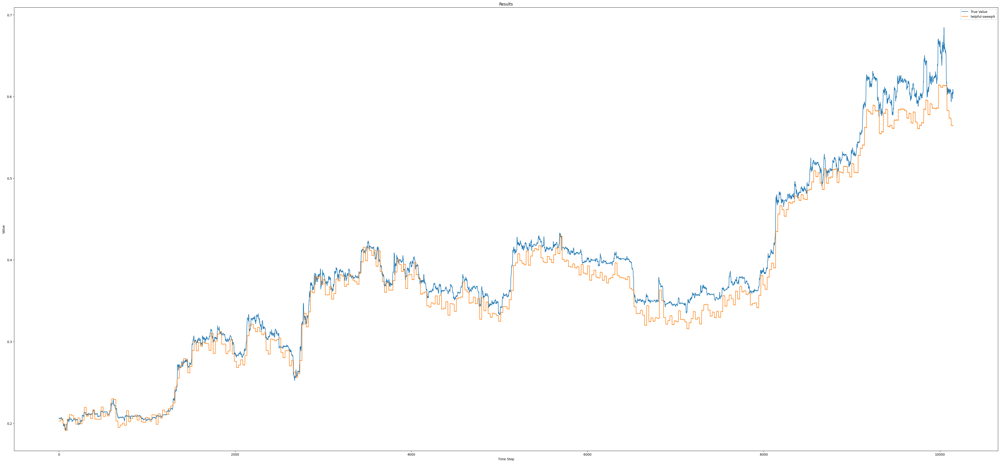

In [53]:
predictionsPlot(predTShelp9, -1, -1,"helpful-sweep9")

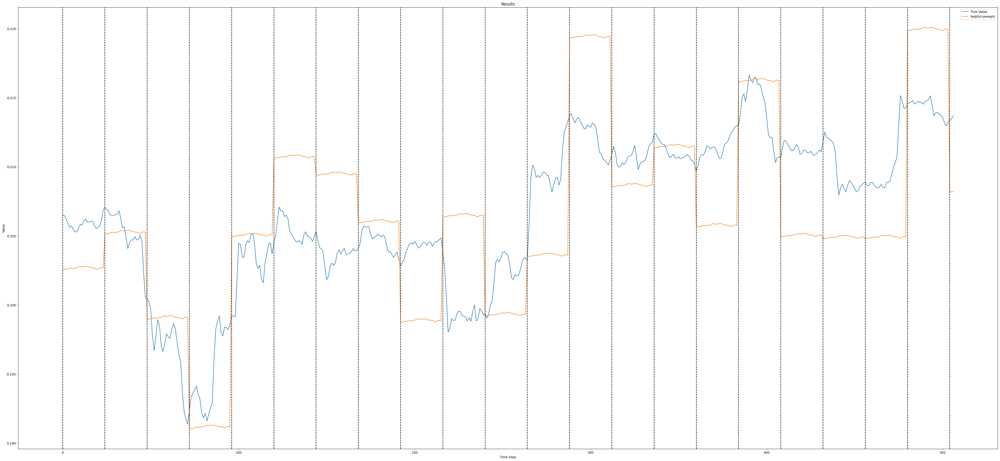

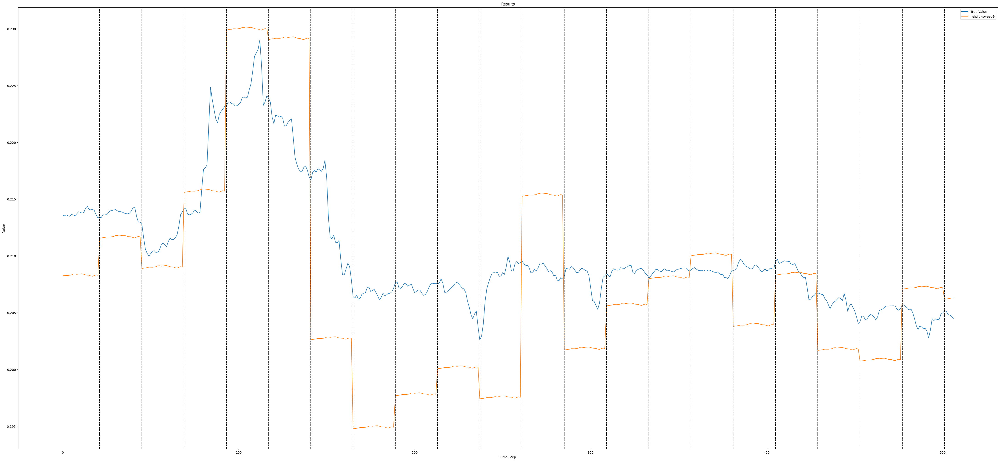

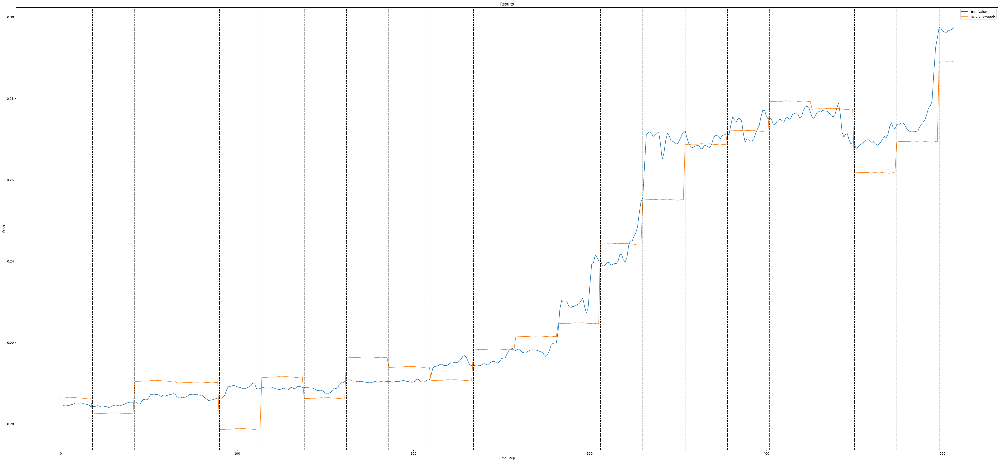

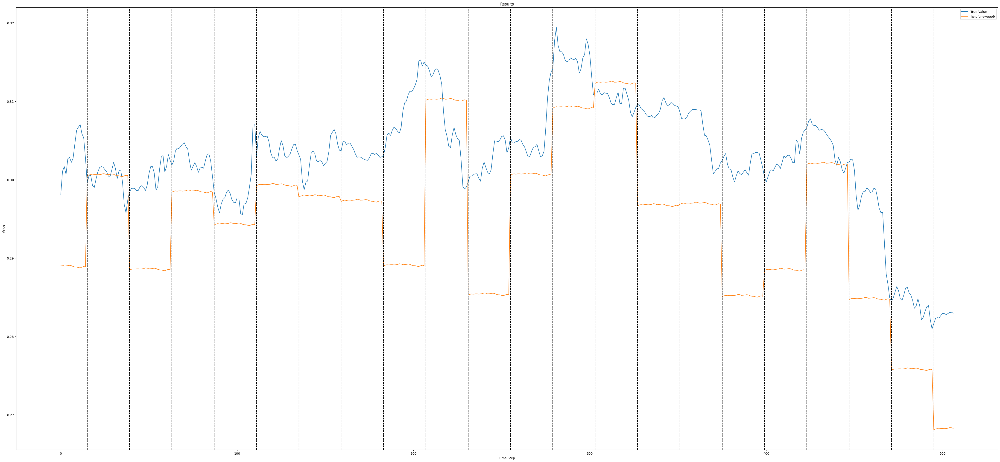

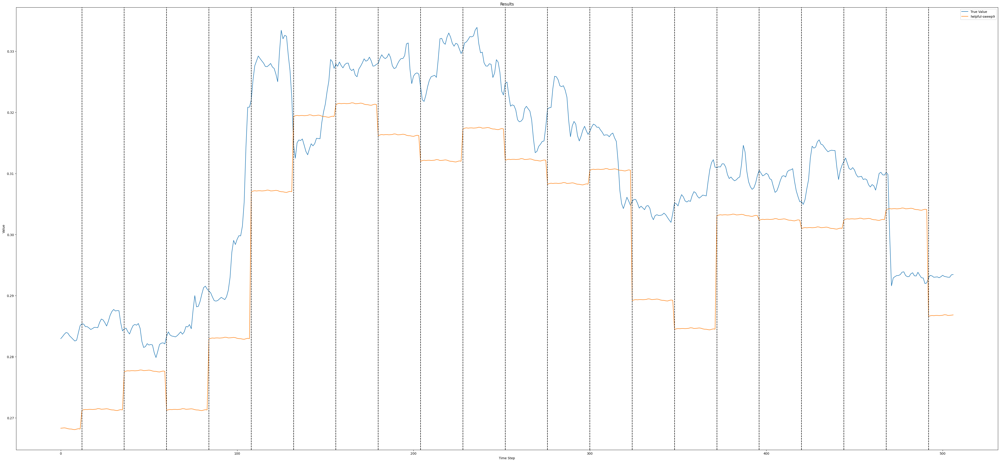

...

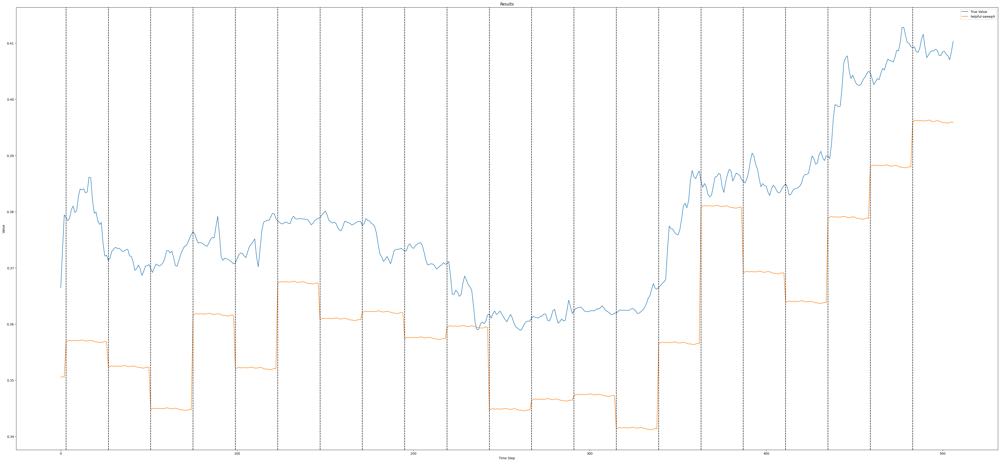

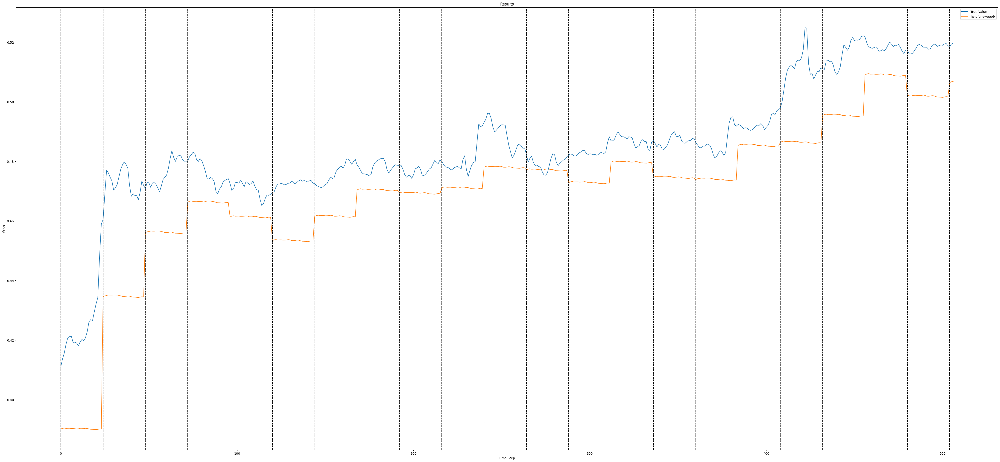

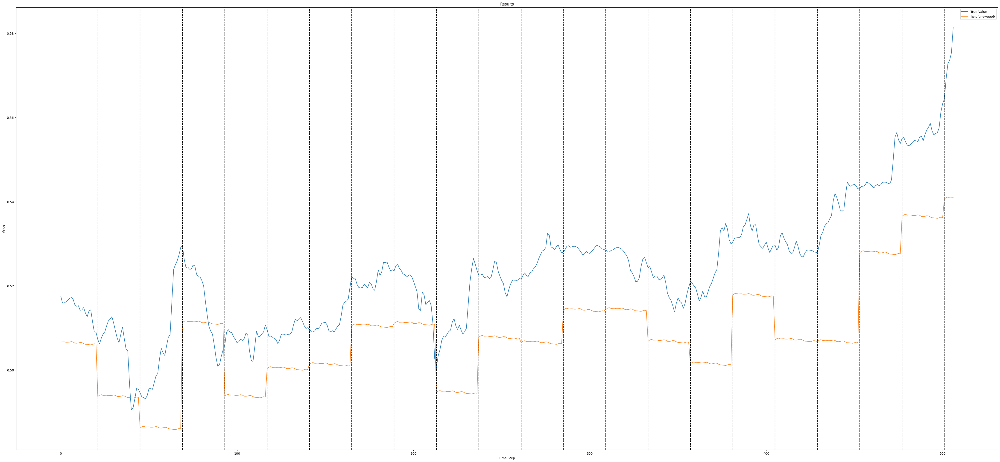

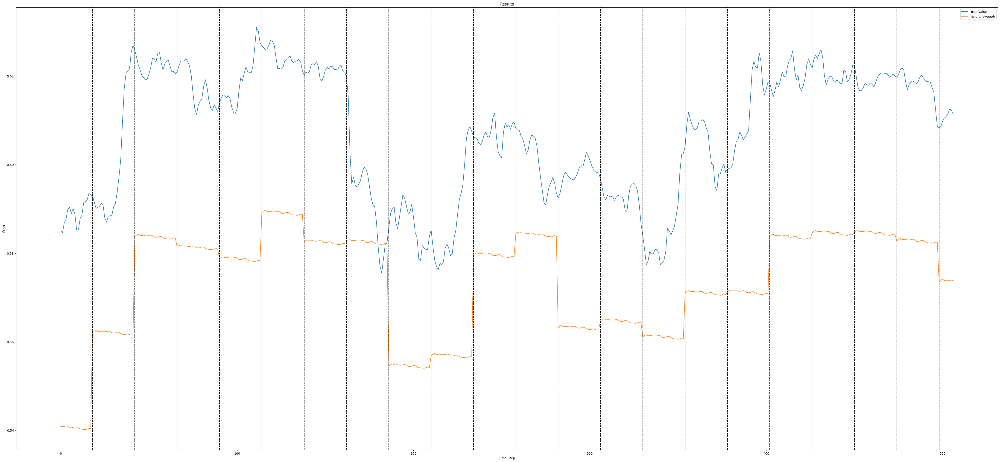

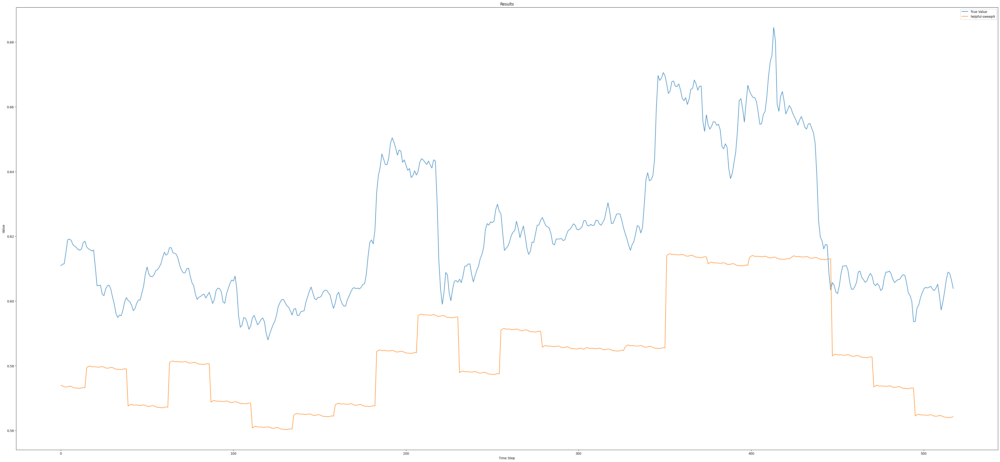

In [52]:
total_steps = len(predTShelp9['targets'])
segment_length = total_steps // 20
for segment in range(20):
    start = segment * segment_length
    if segment < 19:
        end = (segment + 1) * segment_length
    else:
        end = -1  # Ensure we capture the last segment completely in case it doesn't divide evenly
    predictionsPlot(predTShelp9, start, end,"helpful-sweep9")

# Comparisation model design performance

## predictions charts

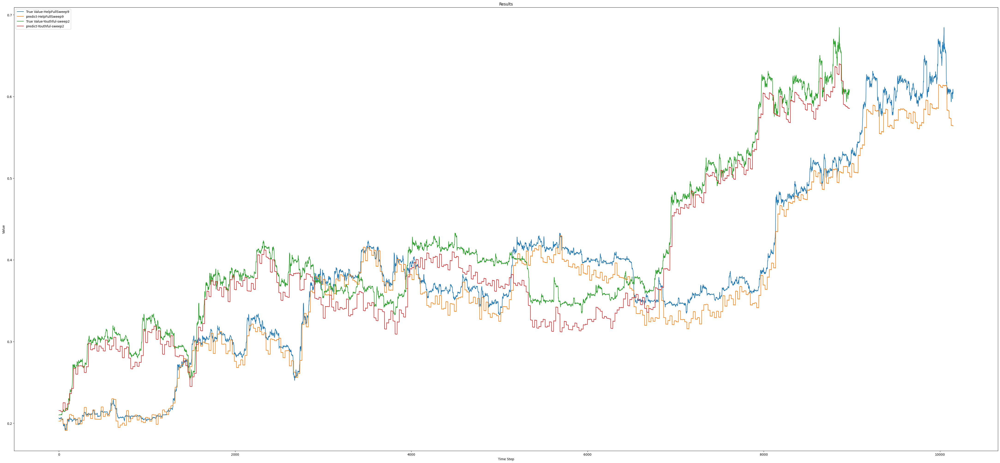

you4 dim:9744 and you2 dim:8976


In [59]:
predictionsPlotVS(predTShelp9,predTSyou2,"-HelpFullSweep9","-Youthful-sweep2",-1,-1)
print(f"you4 dim:{len(predTSyou4)} and you2 dim:{len(predTSyou2)}")


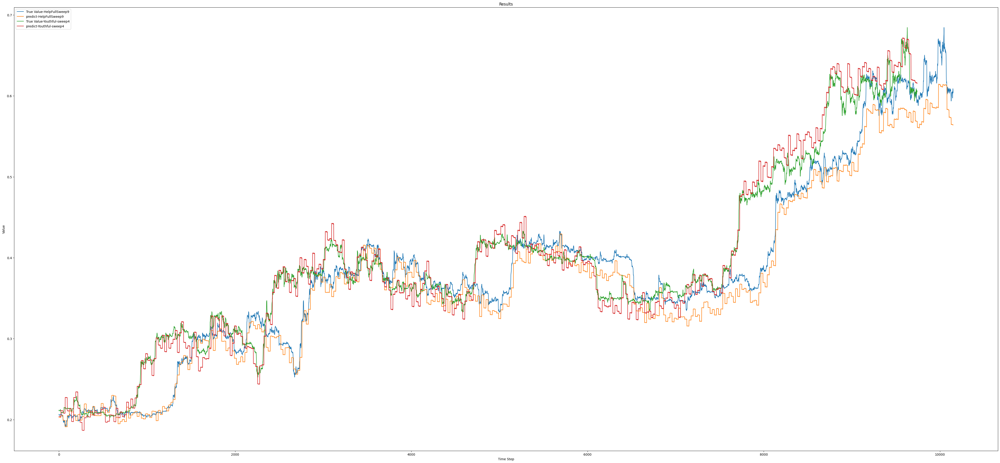

you4 dim:9744 and you2 dim:8976


In [60]:
predictionsPlotVS(predTShelp9,predTSyou4,"-HelpFullSweep9","-Youthful-sweep4",-1,-1)
print(f"you4 dim:{len(predTSyou4)} and you2 dim:{len(predTSyou2)}")

## KPI comparisation table

In [72]:
KPITSyou2['ModelName'] = 'youthful-sweep2'
KPITSyou4['ModelName'] = 'youthful-sweep4'
KPITShelp9["ModelName"] = "helpful-sweep9"
KPITShelp9["Dataset"] = "Test"
KPIrank = pd.concat([KPITSyou2,KPITSyou4])
KPIrank.reset_index(drop=True, inplace=True)
KPIrank.drop(columns=['Unnamed: 0'], inplace=True)
# Rimuovi le colonne "ModelName" e "Dataset" dal DataFrame
model_name_col = KPIrank.pop('ModelName')
dataset_col = KPIrank.pop('Dataset')

# Inserisci le colonne "ModelName" e "Dataset" alle posizioni desiderate
KPIrank.insert(0, 'ModelName', model_name_col)
KPIrank.insert(1, 'Dataset', dataset_col)
KPIrank = pd.concat([KPIrank,KPITShelp9])
test_data = KPIrank[KPIrank['Dataset'] == 'Test']
test_data.head(10)

,ModelName,Dataset,MSE,RMSE,R2,ACCURACY,MAE,AV-AE,Explane variance,ACPER2,ACPER5,APE,DataSet
2,youthful-sweep2,Test,0.000440,0.020977,0.953516,94.599183,0.018701,0.018570,0.989390,14.360517,53.954991,-0.046912,NaN
5,youthful-sweep4,Test,0.000187,0.013658,0.983748,96.557466,0.010854,0.009141,0.983817,41.009852,85.283251,-0.001806,NaN
0,helpful-sweep9,Test,0.000343,0.018521,0.972115,95.692513,0.014914,0.013278,0.988010,26.359338,71.375099,-0.033524,Test
